# Question Answer for images

After posing a series of questions to the GPT-4-Vision-Preview model, it's clear that it functions in a comparable manner to how GPT-3.5-Turbo does for text-based inquiries, but with a focus on visual content. It can effortlessly identify the author of a painting as well as describe what is depicted in an image. In the notebook, a diverse array of questions were tested, including:
 - Who painted the picture?
 - What is depicted in the image?
 - Detailed queries about specific elements within the image.

## Imports and model init

In [1]:
from pathlib import Path

from openai import OpenAI
from gpt4_vision_playground.config import get_openai_key
from IPython.display import Image
from gpt4_vision_playground.config import get_git_root
from gpt4_vision_playground.vision_utils import system_message, user_message_with_image

In [11]:
DATA_DIRECTORY = get_git_root() / "data"
MATEJKO_STANCZYK_IMAGE_PART = DATA_DIRECTORY / 'matejko_stanczyk_part.png'
MATEJKO_STANCZYK_IMAGE_FULL = DATA_DIRECTORY / 'matejko_stanczyk_full.png'
DAMA_Z_LASICZKA = DATA_DIRECTORY / 'dama_z_lasiczka.png'
PEOPLE = DATA_DIRECTORY / 'people.jpeg'
CHESS = DATA_DIRECTORY / 'chess.png'
CARS = DATA_DIRECTORY / 'cars.png'
OPENAI_CLIENT = OpenAI(api_key=get_openai_key())

## QA prepare

In [4]:
def answer_question_for_image(question: str, image_path: Path) -> None:
    print("Question:")
    print(question)
    display(Image(filename=image_path.as_posix(), height=150, width=150))
    response = OPENAI_CLIENT.chat.completions.create(
        model="gpt-4-vision-preview",
        messages=[
            system_message(
                content="You are an artificial intelligence responsible for answering questions related to images. "
                        "Use your whole knowledge."
            ),
            user_message_with_image(
                content=question,
                image_file=image_path
            )
        ],
        max_tokens=4096  # max size
    )
    print("Answer:")
    print(response.choices[0].message.content)

## Answer Questions

### Who painted the image

Question:
What painting is this, and who painted it?


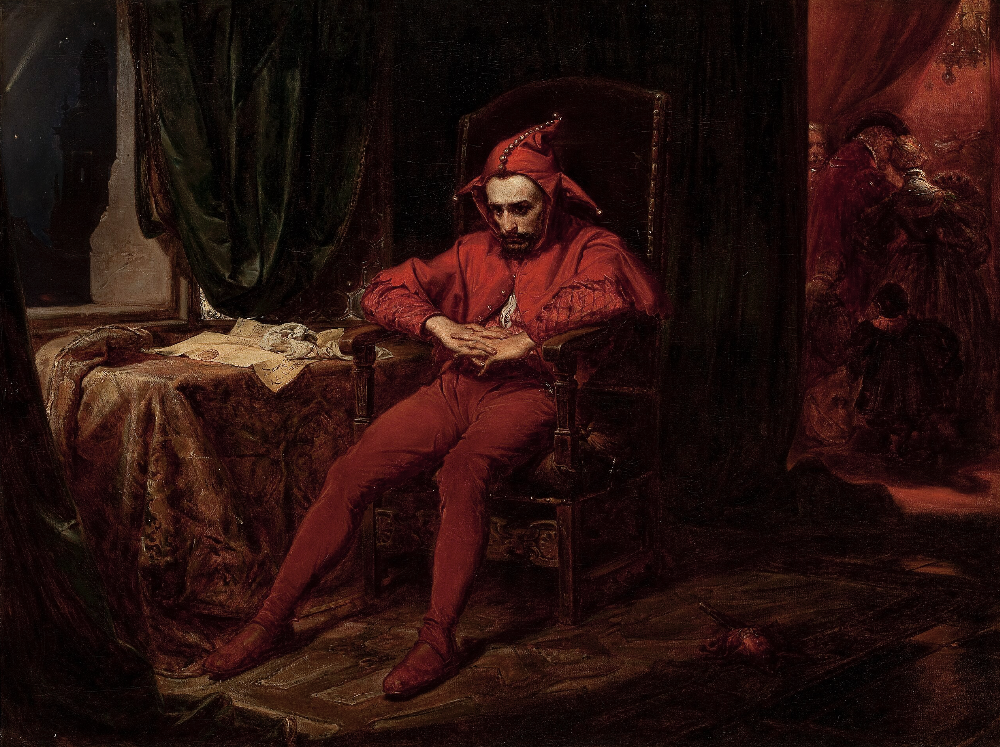

Answer:
The painting is "Stańczyk" by Jan Matejko, painted in 1862. Stańczyk was a famous court jester in Poland during the 16th century, and he is depicted here as a thoughtful figure, representing the tragic wisdom of the fool. Matejko was a renowned Polish painter known for his depictions of significant historical Polish political and military events. The painting illustrates Stańczyk's reaction to the news of the loss of Smolensk during the war with Russia, as is evident by the letter on the table and his pensive expression.


In [4]:
answer_question_for_image("What painting is this, and who painted it?", MATEJKO_STANCZYK_IMAGE_FULL)

Question:
What painting is this, and who painted it?


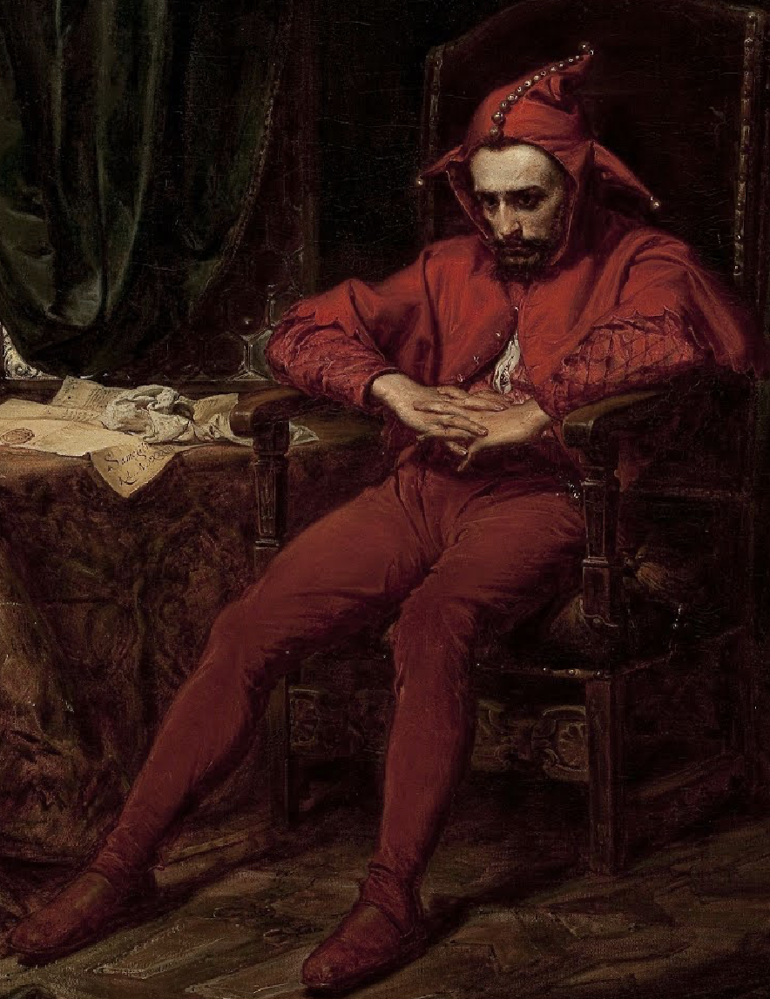

Answer:
This painting is "Stańczyk" by Jan Matejko, a renowned 19th-century Polish painter known for his detailed historical scenes. The painting depicts Stańczyk, who was a famous court jester in Poland during the 16th century. He is often portrayed as a symbol of wisdom and the spirit of Poland, and Matejko's portrayal captures a poignant moment of reflection and sorrow, possibly relating to a historical event affecting Poland that the jester is contemplating. The painting is esteemed for its evocative portrayal of the jester's thoughtful expression, which contrasts with his established role as an entertainer.


In [5]:
answer_question_for_image("What painting is this, and who painted it?", MATEJKO_STANCZYK_IMAGE_PART)

Question:
This is part of a famous painting. What painting is this, and who painted it?


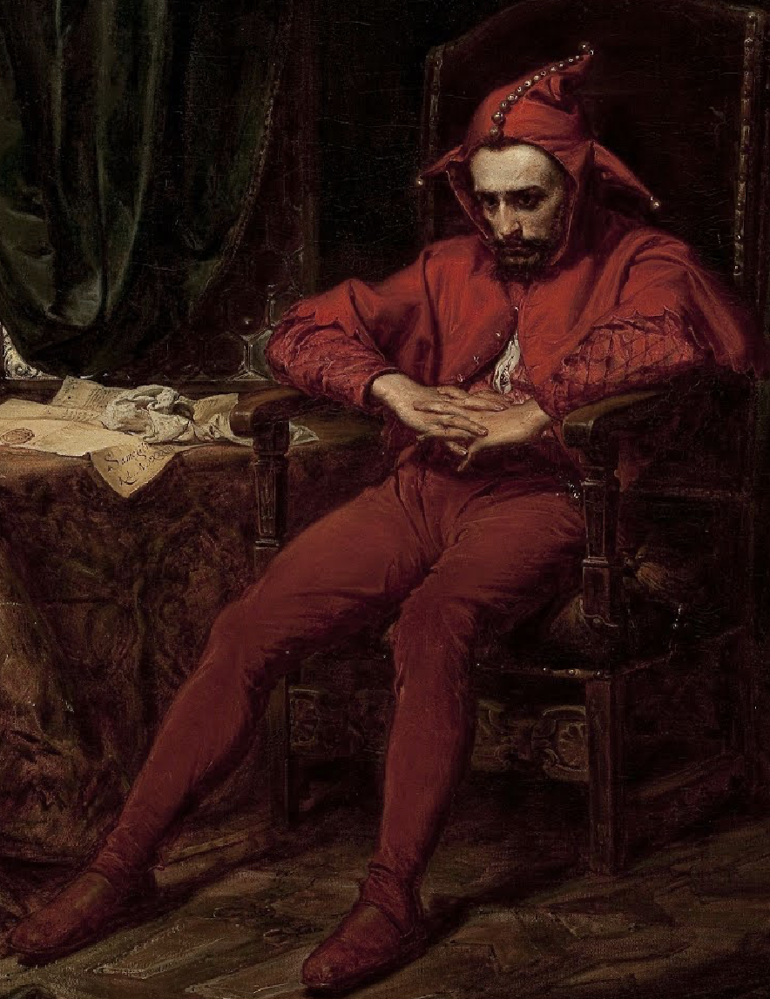

Answer:
This image is a detail from the painting "The Cardinal," painted by the French artist Jean-Léon Gérôme. Gérôme was a prominent 19th-century painter and sculptor known for his work in the academicism style. His paintings often depicted historical or classical subjects with a polished realism, and "The Cardinal" is a fine example of his meticulous approach to detail and texture.


In [6]:
answer_question_for_image("This is part of a famous painting. What painting is this, and who painted it?", MATEJKO_STANCZYK_IMAGE_PART)

Question:
What painting is this, and who painted it?


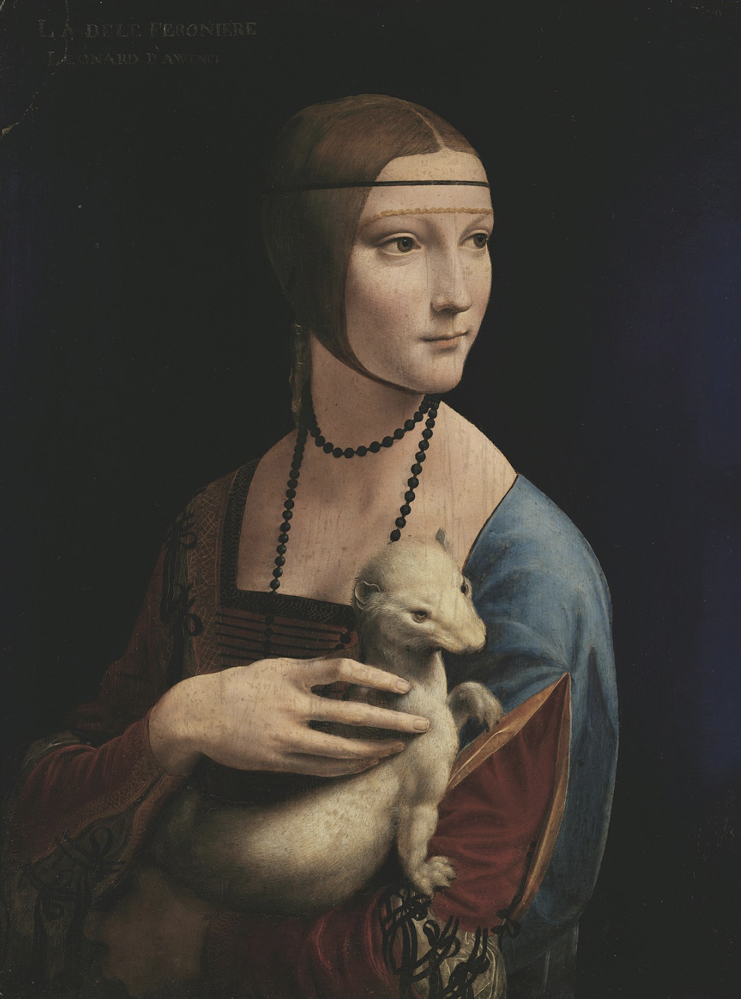

Answer:
This painting is known as "Lady with an Ermine" by Leonardo da Vinci. The subject is believed to be Cecilia Gallerani, who was the mistress of Ludovico Sforza, Duke of Milan at the time Leonardo was at the Sforza court. The painting is one of only a few female portraits Leonardo created and is noted for its exquisite detail and the charming portrayal of the ermine.


In [20]:
answer_question_for_image("What painting is this, and who painted it?", DAMA_Z_LASICZKA)

### Whats on image

Question:
What is on image?


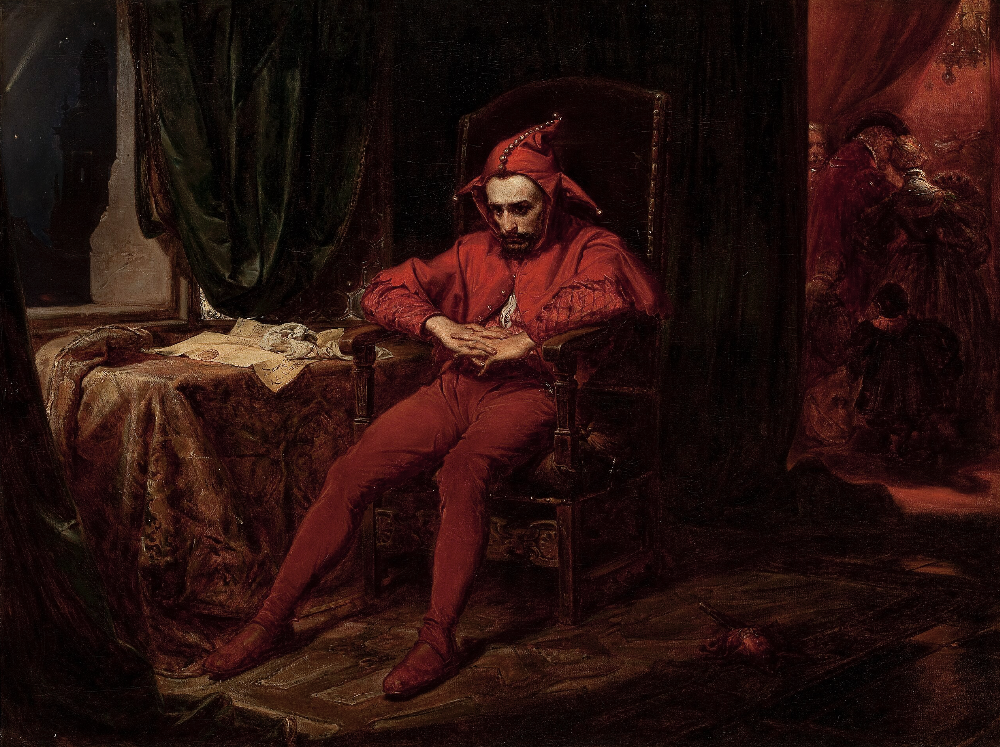

Answer:
The image depicts a painting of a man sitting in a state of despondence. He's dressed in a vibrant red, classically styled jester's outfit, complete with a cap and bells. His expression is one of sadness or contemplation, which contrasts with the traditional role of a jester to entertain and amuse. Around him are symbols of his profession like scattered papers, possibly scripts or music, and a small lute on the floor, indicating his artistic pursuits.

The setting seems to be within a grand room, suggested by the heavy curtains and ornate furnishings. Additionally, the background gives a glimpse of a balcony or window, and there is a suggestion of another figure dressed similarly in the shadows on the right, possibly indicating a sense of companionship or a mirror of his own state of mind.

This contrast between the jester's attire and his forlorn expression invites a reflection on themes such as the dichotomy between appearance and reality or the sadness that can lie beneath t

In [14]:
answer_question_for_image("What is on image?", MATEJKO_STANCZYK_IMAGE_FULL)

Question:
What is on image?


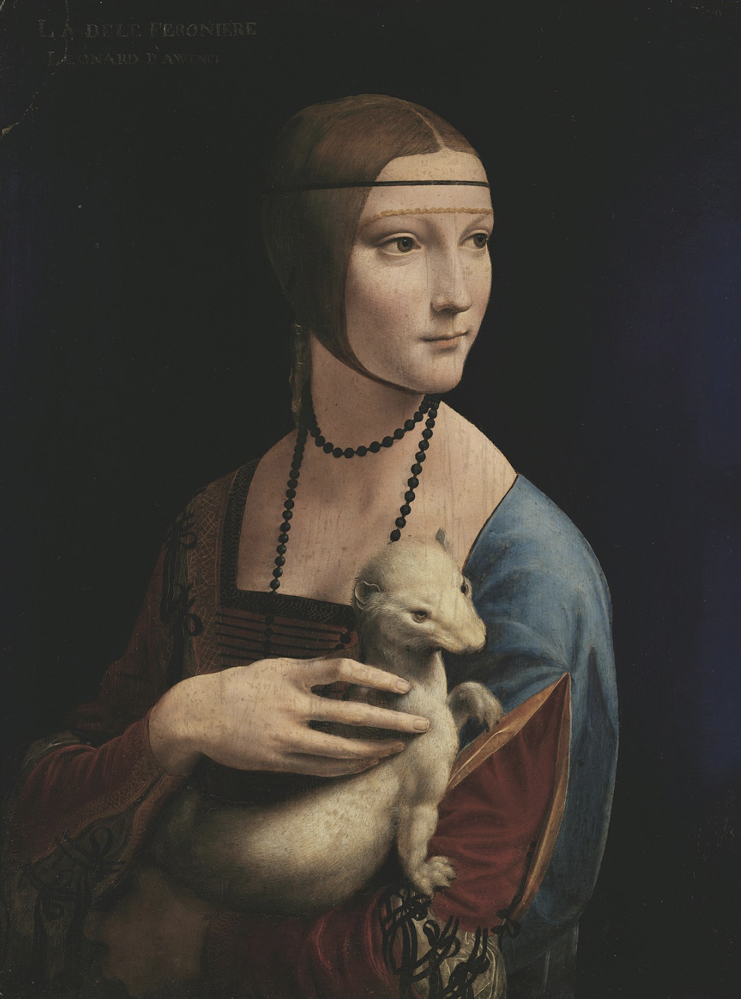

Answer:
The image displays a famous painting known as "Lady with an Ermine" by Leonardo da Vinci, depicting a young woman holding an ermine. The woman is dressed in renaissance clothing and is shown in profile against a dark background. The ermine, which the woman is gently holding in her arms, symbolizes purity and is associated with the sitter's personal emblem. The painting is regarded as one of da Vinci's masterpieces and reflects his skill in capturing both the human figure and the texture and form of the ermine with great detail and lifelike presence.


In [18]:
answer_question_for_image("What is on image?", DAMA_Z_LASICZKA)

Question:
What is on image?


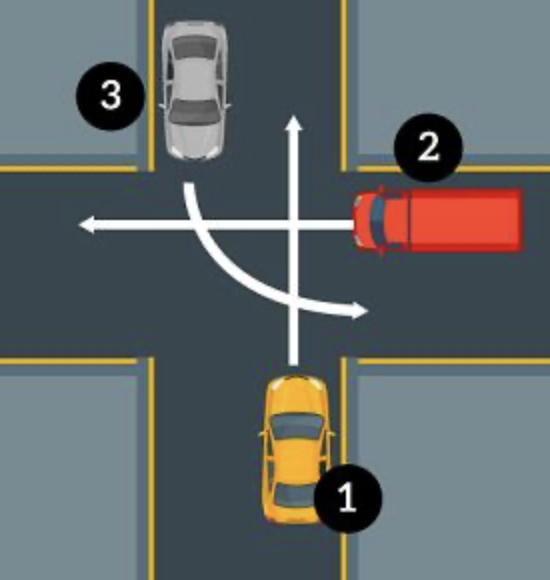

Answer:
This image appears to be a diagram or illustration showing a traffic situation with three cars at an intersection. The cars are labeled with numbers 1, 2, and 3, indicating that they might be used for a question or discussion about the rules of the road, right-of-way, or driving test scenarios. There are white arrows on the roadway indicating the direction of traffic flow or possibly suggested movement paths for the vehicles. The layout suggests that the car labeled "1" wishes to proceed straight ahead, while the car labeled with "2" seems to be in a situation to turn, and the arrow above car "3" suggests that it may also move forward or possibly turn left.


In [19]:
answer_question_for_image("What is on image?", CARS)

### Difficult questions

Question:
In what order should the cars leave the intersection? Answer shortly


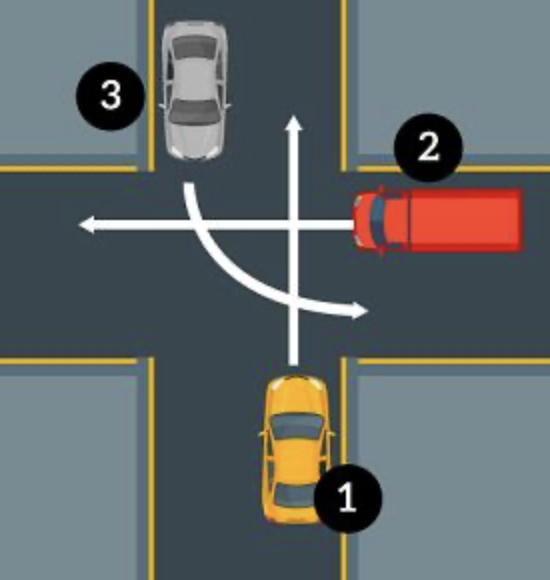

Answer:
The cars should leave the intersection in the following order: 1, 2, 3.


In [5]:
answer_question_for_image("In what order should the cars leave the intersection? Answer shortly", CARS)

Question:
How many people are on image?


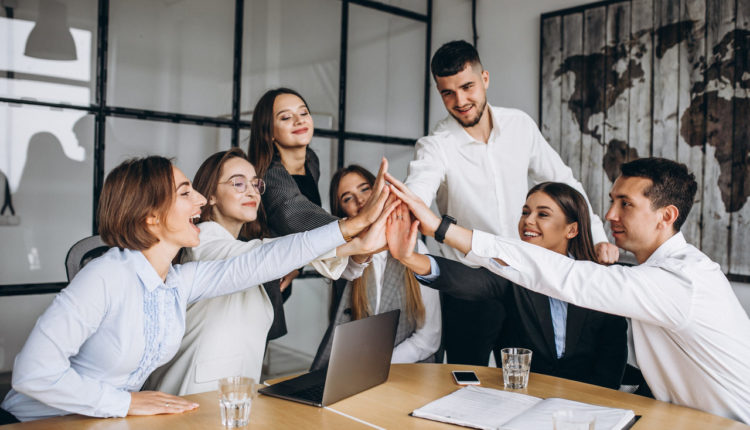

Answer:
There are seven people in the image. They appear to be gathered around a table in an office setting, celebrating or participating in a group high-five.


In [6]:
answer_question_for_image("How many people are on image?", PEOPLE)

Question:
How many glass on the table are on image?


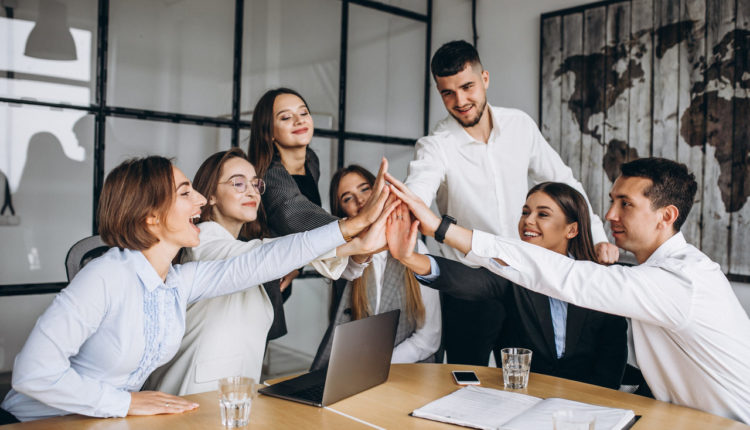

Answer:
There is one glass visible on the table in this image.


In [8]:
answer_question_for_image("How many glass on the table are on image?", PEOPLE)

Question:
How many cars are on the image?


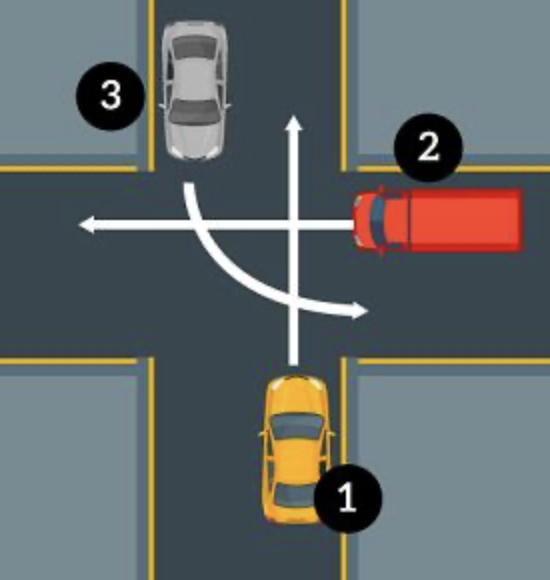

Answer:
There are three cars shown in the image.


In [9]:
answer_question_for_image("How many cars are on the image?", CARS)

Question:
On the chessboard, White delivers checkmate in one move, write down the move. Give simple answer.


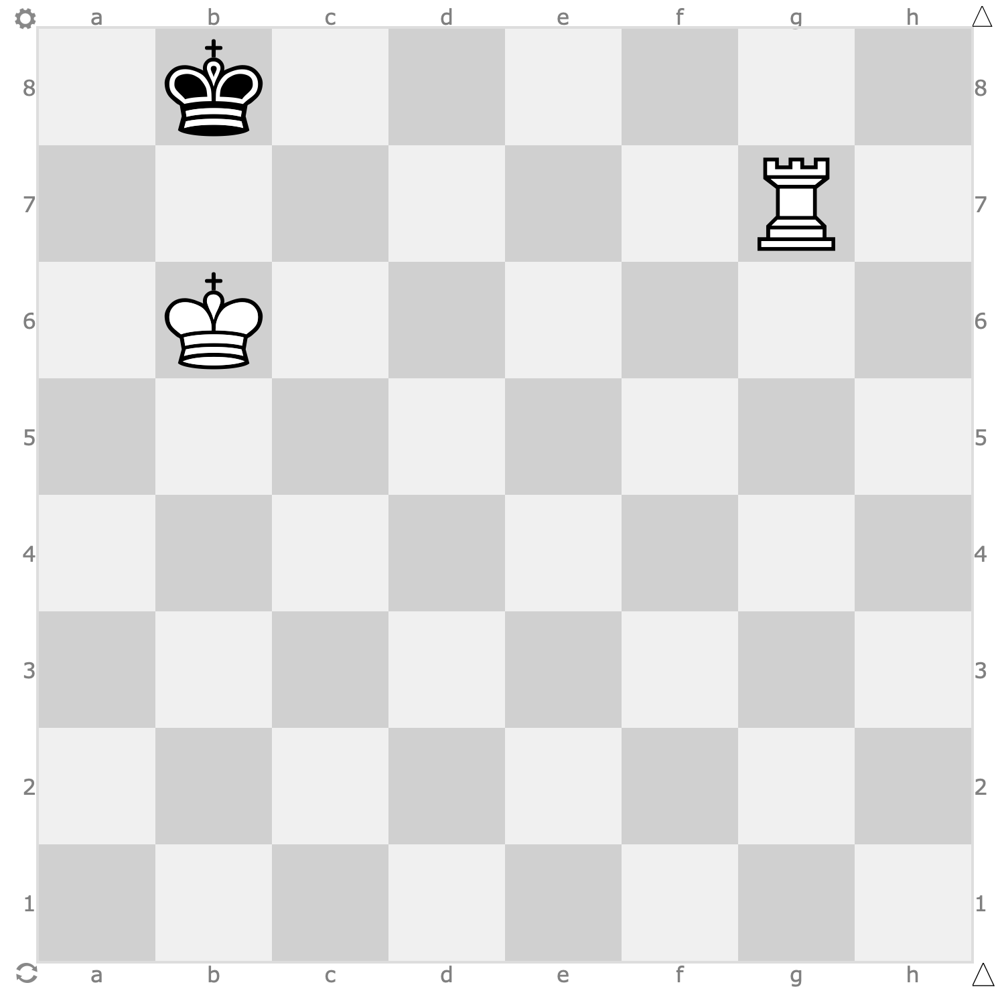

Answer:
Rg8#


In [17]:
answer_question_for_image(
    "On the chessboard, White delivers checkmate in one move, write down the move. Give simple answer.", 
    CHESS
)

## Observation